In [ ]:
import os
import time
import datetime
import psutil
import json
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.preprocessing.image import array_to_img
from google.colab import drive

drive.mount('/content/drive')

save_path = '/content/drive/MyDrive/RiceDeepMLFinalProjectTrainingModels'

if os.path.exists(save_path):
    print("Path exists")
else:
    print("Path does not exist")
    print(f"Creating folder: {save_path}")
    os.makedirs(save_path)

KAGGLE_USERNAME = "RandomHuman003"
KAGGLE_KEY = "KGAT_44e9e9c89859fb119cf9fb9a48277cd9"

os.makedirs(os.path.expanduser("~/.kaggle"), exist_ok=True)
kaggle_config = {"username": KAGGLE_USERNAME, "key": KAGGLE_KEY}

with open(os.path.expanduser("~/.kaggle/kaggle.json"), "w") as f:
    json.dump(kaggle_config, f)

os.chmod(os.path.expanduser("~/.kaggle/kaggle.json"), 0o600)
print("Kaggle API token set successfully!")

# Global settings
tf.keras.mixed_precision.set_global_policy('mixed_float16')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Path exists
Kaggle API token set successfully!


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
SAVE_DIR = "/content/drive/MyDrive/gan_models"
os.makedirs(SAVE_DIR, exist_ok=True)
print("Model save directory:", SAVE_DIR)

Model save directory: /content/drive/MyDrive/gan_models


In [ ]:
class SaveToDriveCallback(keras.callbacks.Callback):
    def __init__(self, save_path, save_every_n_epochs=5):
        super(SaveToDriveCallback, self).__init__()
        self.save_path = save_path
        self.save_every_n_epochs = save_every_n_epochs

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.save_every_n_epochs == 0:
            # Save generator to Drive
            filename = f"generator_epoch_{epoch+1}.keras"
            full_path = os.path.join(self.save_path, filename)
            self.model.generator.save(full_path)
            print(f"\n[Checkpoint] Saved to: {full_path}")

In [ ]:
# Enable mixed precision for faster training
tf.keras.mixed_precision.set_global_policy('mixed_float16')

Kaggle API token set successfully!
Dataset URL: https://www.kaggle.com/datasets/soumikrakshit/anime-faces
License(s): unknown
 74% 325M/441M [00:00<00:00, 1.71GB/s]
100% 441M/441M [00:00<00:00, 1.71GB/s]
Dataset downloaded and extracted!
Dataset folder detected: anime_faces_data/data
Total images found: 21551


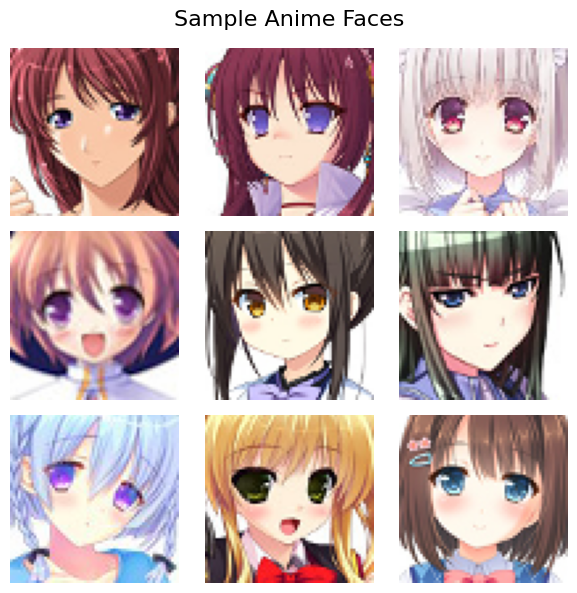

In [ ]:
!pip install -q kaggle

import os
import json

KAGGLE_USERNAME = "RandomHuman003"
KAGGLE_KEY = "KGAT_44e9e9c89859fb119cf9fb9a48277cd9"

os.makedirs(os.path.expanduser("~/.kaggle"), exist_ok=True)
kaggle_config = {
    "username": KAGGLE_USERNAME,
    "key": KAGGLE_KEY
}

with open(os.path.expanduser("~/.kaggle/kaggle.json"), "w") as f:
    json.dump(kaggle_config, f)

os.chmod(os.path.expanduser("~/.kaggle/kaggle.json"), 0o600)
print("Kaggle API token set successfully!")

!kaggle datasets download -d soumikrakshit/anime-faces
!unzip -q anime-faces.zip -d anime_faces_data
print("Dataset downloaded and extracted!")

BASE_DIR = ""
for root, dirs, files in os.walk("anime_faces_data"):
    if any(f.endswith('.png') for f in files):
        BASE_DIR = root
        break

if BASE_DIR == "":
    raise FileNotFoundError("No PNG images found in the dataset folder!")

print("Dataset folder detected:", BASE_DIR)

image_paths = [os.path.join(BASE_DIR, f) for f in os.listdir(BASE_DIR) if f.endswith('.png')]
print(f"Total images found: {len(image_paths)}")

import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img

plt.figure(figsize=(6,6))
for i, img_path in enumerate(image_paths[:9]):
    plt.subplot(3,3,i+1)
    img = load_img(img_path, target_size=(64,64))
    plt.imshow(img)
    plt.axis('off')
plt.suptitle("Sample Anime Faces", fontsize=16)
plt.tight_layout()
plt.show()


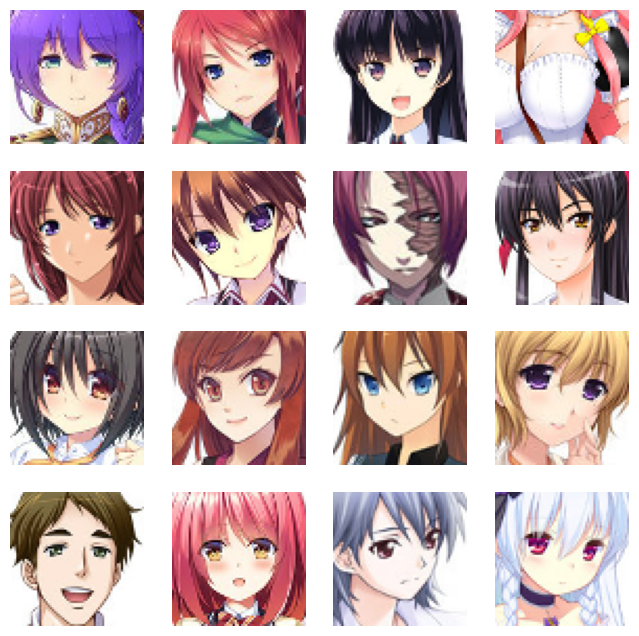

In [ ]:
# Data Pipeline
IMG_SIZE = 64
BATCH_SIZE = 64
AUTOTUNE = tf.data.AUTOTUNE

def preprocess(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_png(img, channels=3)
    img = tf.image.resize(img, [IMG_SIZE, IMG_SIZE])
    img = (img / 127.5) - 1.0   # normalize to [-1, 1]
    return img

dataset = tf.data.Dataset.from_tensor_slices(image_paths)
dataset = dataset.map(preprocess, num_parallel_calls=AUTOTUNE)
dataset = dataset.shuffle(2048).batch(BATCH_SIZE).prefetch(AUTOTUNE)

# Visualize some images
plt.figure(figsize=(8,8))
for i, img in enumerate(dataset.take(1).as_numpy_iterator().__next__()[:16]):
    plt.subplot(4,4,i+1)
    plt.imshow((img + 1) / 2)
    plt.axis('off')
plt.show()


In [ ]:
# Model Parameters
LATENT_DIM = 100
CHANNELS = 3
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)


In [ ]:
# Generator

def build_generator():
    model = keras.Sequential(name='generator')
    model.add(layers.Dense(8*8*512, input_dim=LATENT_DIM, kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    model.add(layers.Reshape((8, 8, 512)))

    # 16x16
    model.add(layers.Conv2DTranspose(256, (4,4), strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    # 32x32
    model.add(layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    # 64x64
    model.add(layers.Conv2DTranspose(64, (4,4), strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    # Output layer
    model.add(layers.Conv2D(CHANNELS, (4,4), padding='same', activation='tanh'))
    return model

generator = build_generator()
generator.summary()


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 32768)          │     3,309,568 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 32768)          │       131,072 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu (ReLU)                    │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_1 (ReLU)                  │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_2 (ReLU)                  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 64, 64, 64)     │       131,136 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 64, 64, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_3 (ReLU)                  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 3)      │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,198,467 (23.65 MB)

 Trainable params: 6,132,035 (23.39 MB)

 Non-trainable params: 66,432 (259.50 KB)

In [ ]:
# Discriminator
def build_discriminator():
    alpha = 0.2
    model = keras.Sequential(name='discriminator')
    model.add(layers.Conv2D(64, (4,4), strides=(2,2), padding='same', input_shape=(IMG_SIZE, IMG_SIZE, CHANNELS)))
    model.add(layers.LeakyReLU(alpha))
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (4,4), strides=(2,2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha))
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(256, (4,4), strides=(2,2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha))
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1, activation='sigmoid', dtype='float32'))  # force float32 output
    return model

discriminator = build_discriminator()
discriminator.summary()


/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 8, 8, 256)      │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 8, 8, 256)      │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 8, 8, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 8, 8, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 16384)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │        16,385 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 676,801 (2.58 MB)

 Trainable params: 676,033 (2.58 MB)

 Non-trainable params: 768 (3.00 KB)

In [ ]:
# DCGAN Class
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        random_noise = tf.random.normal([batch_size, self.latent_dim])

        # Train Discriminator
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_noise, training=True)
            real_labels = tf.ones((batch_size,1)) - 0.1*tf.random.uniform((batch_size,1))  # label smoothing
            fake_labels = tf.zeros((batch_size,1))

            real_output = self.discriminator(real_images, training=True)
            fake_output = self.discriminator(fake_images, training=True)

            d_loss_real = self.loss_fn(real_labels, real_output)
            d_loss_fake = self.loss_fn(fake_labels, fake_output)
            d_loss = (d_loss_real + d_loss_fake)/2

        grads = tape.gradient(d_loss, self.discriminator.trainable_variables)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_variables))

        # Train Generator
        misleading_labels = tf.ones((batch_size,1))
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_noise, training=True)
            pred = self.discriminator(fake_images, training=True)
            g_loss = self.loss_fn(misleading_labels, pred)

        grads = tape.gradient(g_loss, self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_variables))

        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {"d_loss": self.d_loss_metric.result(), "g_loss": self.g_loss_metric.result()}


In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=LATENT_DIM):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        self.noise = tf.random.normal([num_imgs, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        generated = self.model.generator(self.noise)
        generated = (generated + 1) * 127.5
        generated = tf.cast(generated, tf.uint8)

        # Show images
        plt.figure(figsize=(8,8))
        for i in range(self.num_imgs):
            plt.subplot(5,5,i+1)
            plt.imshow(array_to_img(generated[i]))
            plt.axis('off')
        plt.show()

        # Save generator to Google Drive
        save_path = f"/content/drive/MyDrive/gan_models/generator_epoch_{epoch+1}.keras"
        self.model.generator.save(save_path)
        print(f"Saved generator to: {save_path}")


In [ ]:
generator.save("/content/drive/MyDrive/gan_models/generator_final.keras")
discriminator.save("/content/drive/MyDrive/gan_models/discriminator_final.keras")


Epoch 1/50
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - d_loss: 0.2498 - g_loss: 5.0024

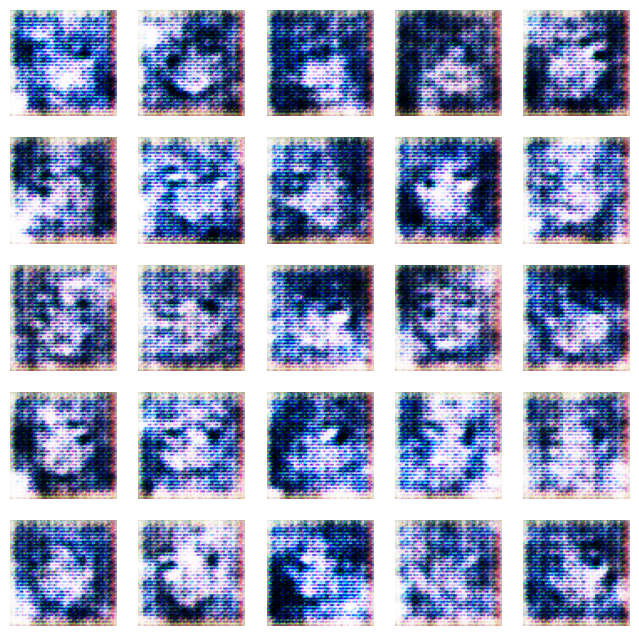

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_1.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 46s 66ms/step - d_loss: 0.2498 - g_loss: 5.0029
Epoch 2/50
331/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.2061 - g_loss: 5.6717

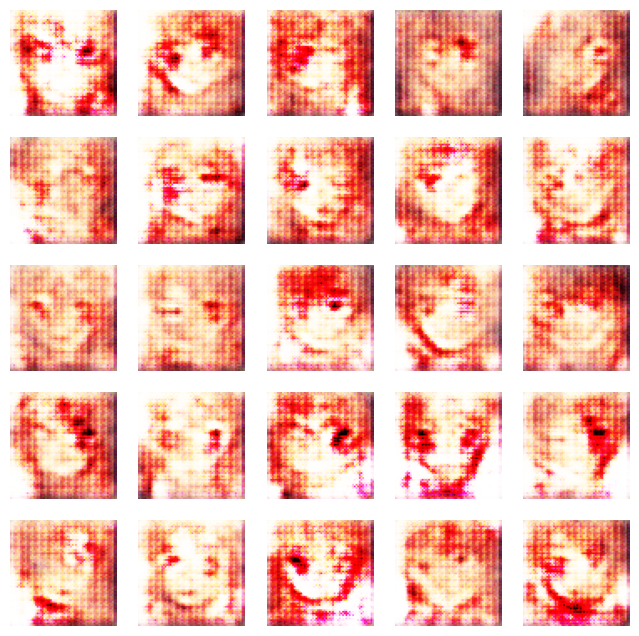

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_2.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - d_loss: 0.2061 - g_loss: 5.6680
Epoch 3/50
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.1871 - g_loss: 4.9867

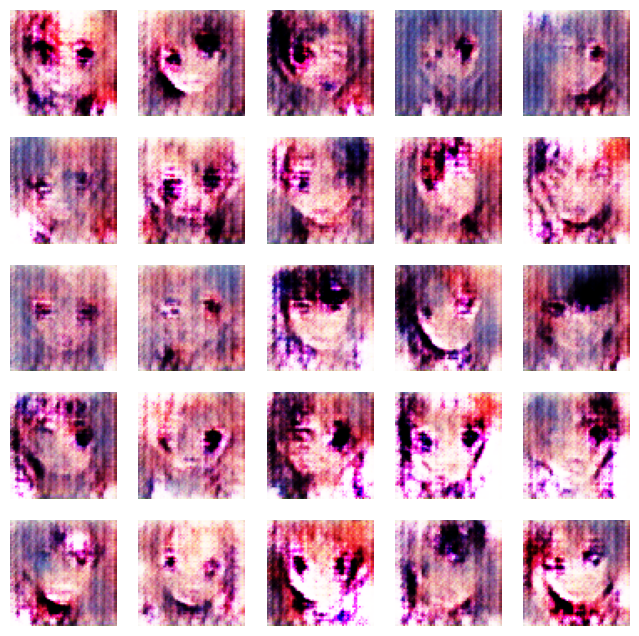

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_3.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 20ms/step - d_loss: 0.1871 - g_loss: 4.9866
Epoch 4/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.2265 - g_loss: 5.0976

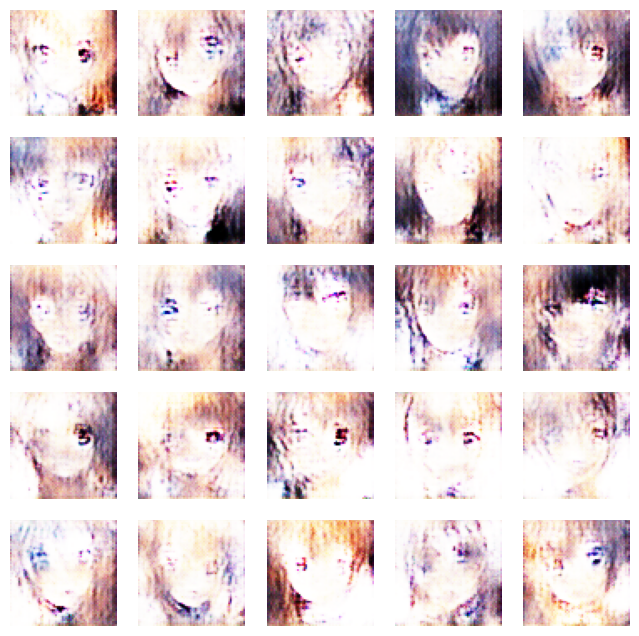

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_4.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - d_loss: 0.2262 - g_loss: 5.0941
Epoch 5/50
336/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.2342 - g_loss: 4.8985

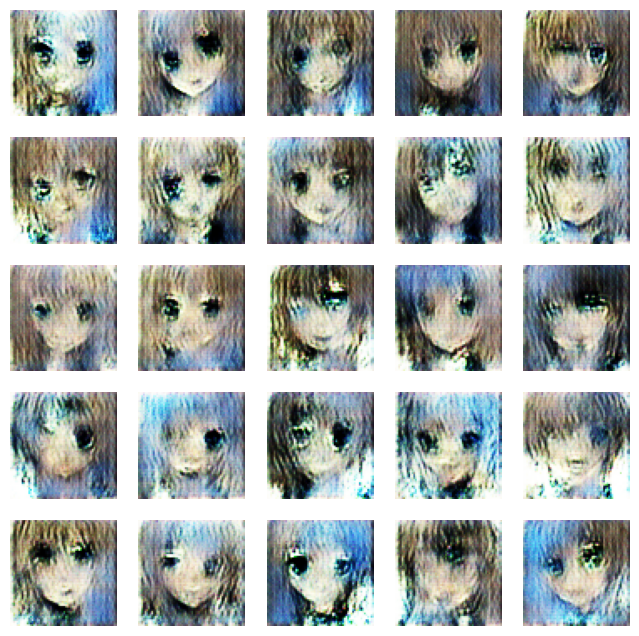

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_5.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 8s 22ms/step - d_loss: 0.2342 - g_loss: 4.8979
Epoch 6/50
336/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.2053 - g_loss: 4.3685

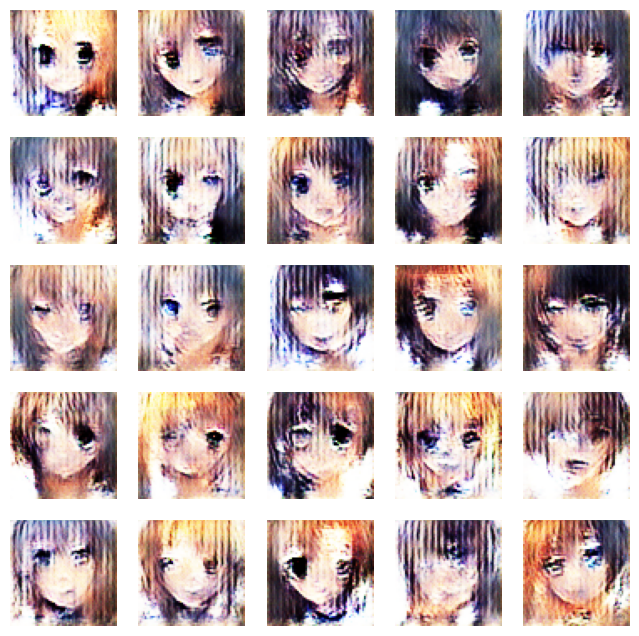

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_6.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.2053 - g_loss: 4.3688
Epoch 7/50
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.2587 - g_loss: 4.6402

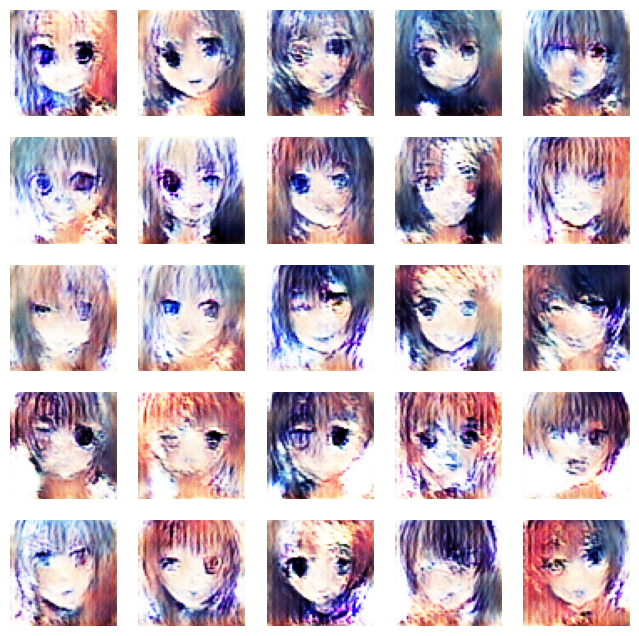

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_7.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - d_loss: 0.2586 - g_loss: 4.6401
Epoch 8/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3022 - g_loss: 4.4551

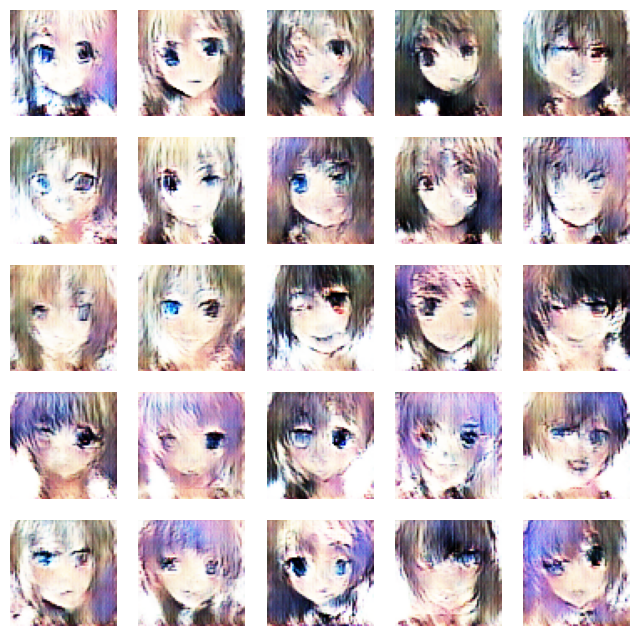

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_8.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.3012 - g_loss: 4.4553
Epoch 9/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3317 - g_loss: 4.3492

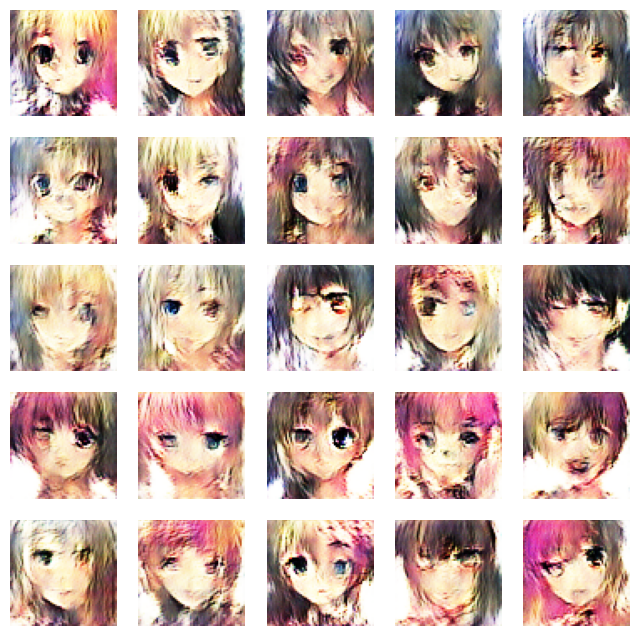

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_9.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.3314 - g_loss: 4.3448
Epoch 10/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.2971 - g_loss: 3.9468

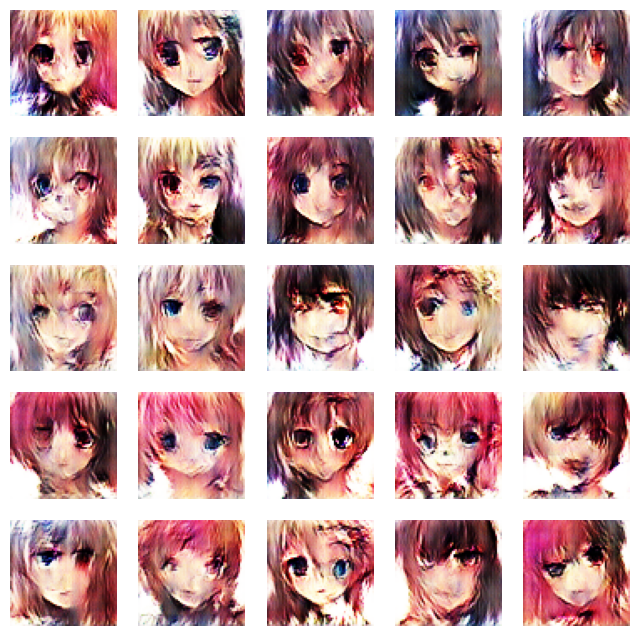

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_10.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.2971 - g_loss: 3.9451
Epoch 11/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3109 - g_loss: 3.6694

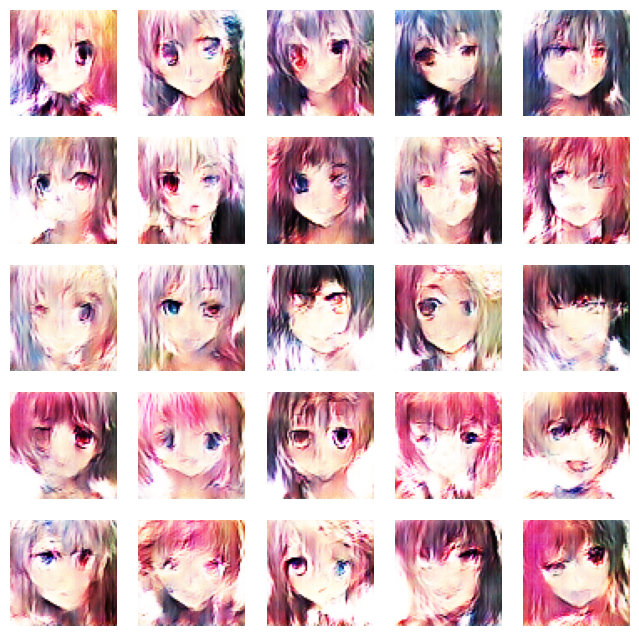

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_11.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - d_loss: 0.3113 - g_loss: 3.6683
Epoch 12/50
331/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3087 - g_loss: 3.4109

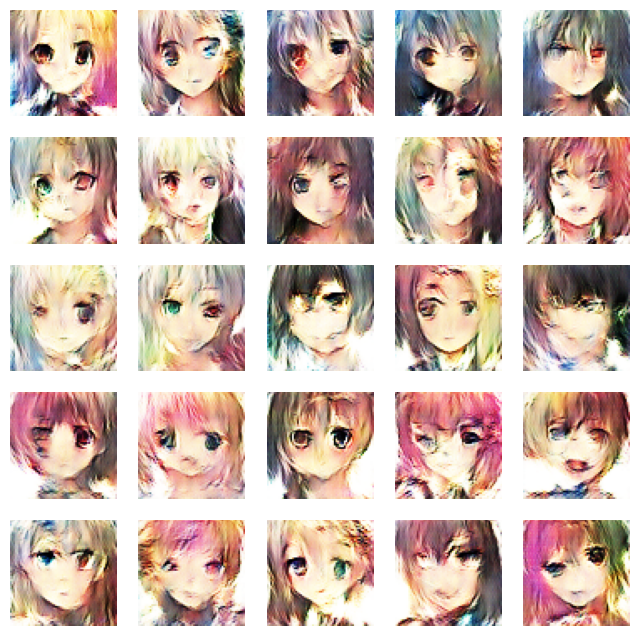

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_12.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 8s 25ms/step - d_loss: 0.3091 - g_loss: 3.4104
Epoch 13/50
335/337 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - d_loss: 0.3169 - g_loss: 3.3009

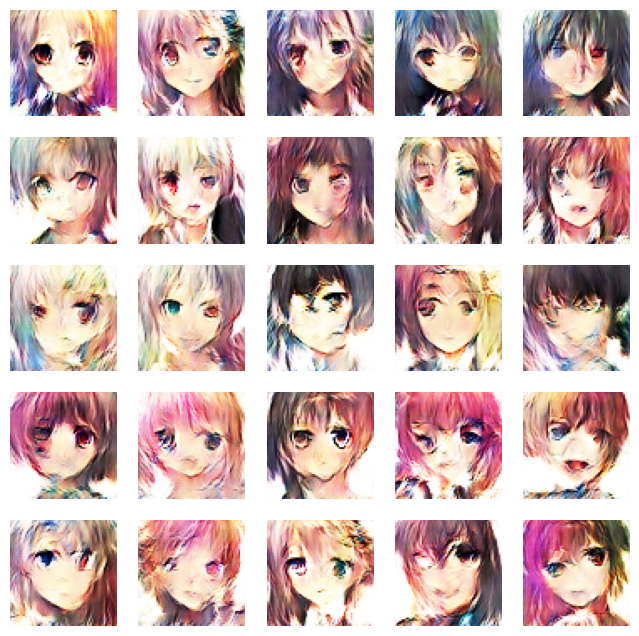

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_13.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - d_loss: 0.3173 - g_loss: 3.3011
Epoch 14/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3111 - g_loss: 3.1715

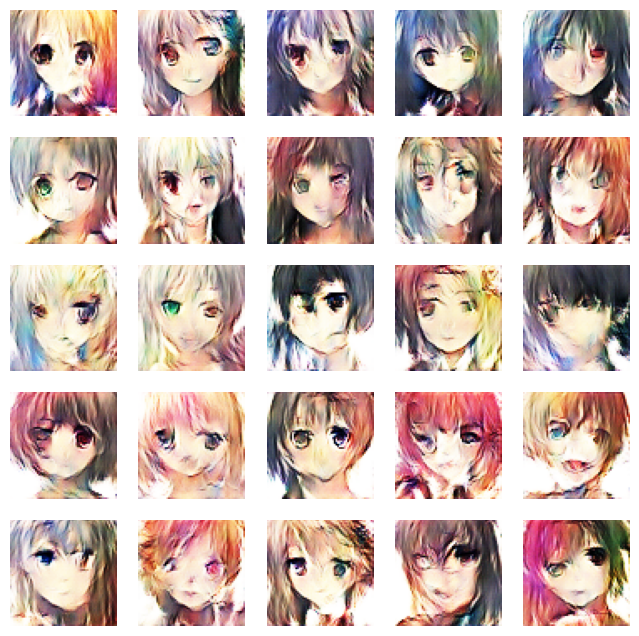

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_14.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.3115 - g_loss: 3.1723
Epoch 15/50
336/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3281 - g_loss: 3.2195

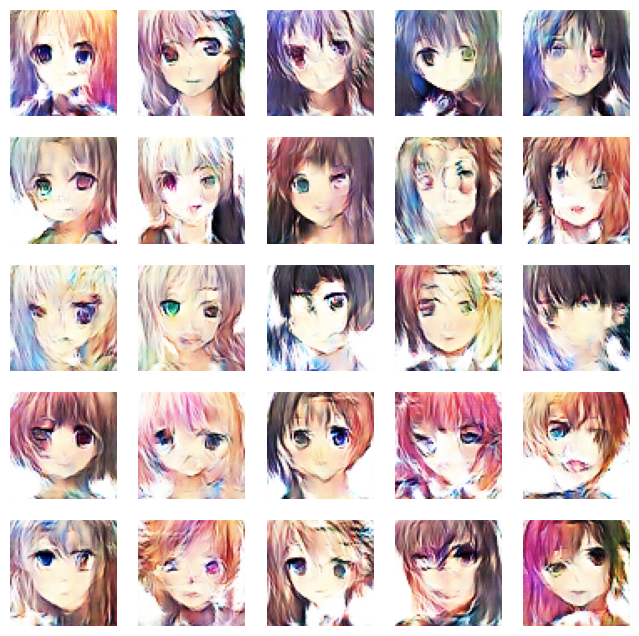

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_15.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - d_loss: 0.3281 - g_loss: 3.2195
Epoch 16/50
335/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3243 - g_loss: 3.1955

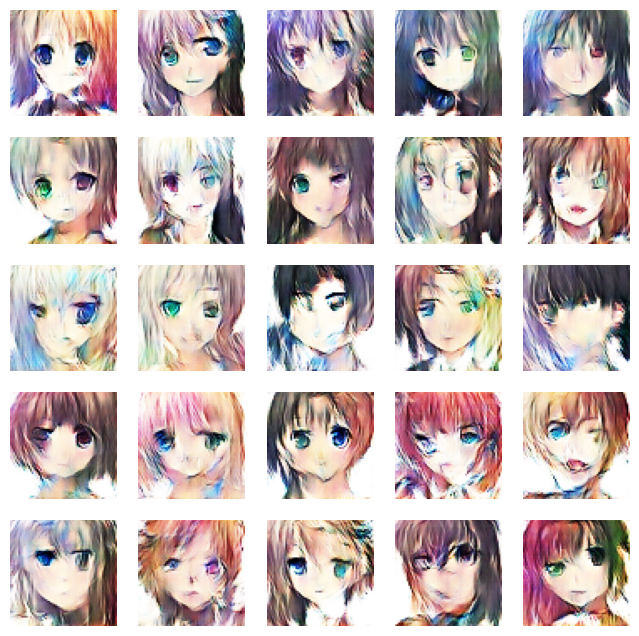

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_16.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.3244 - g_loss: 3.1956
Epoch 17/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3791 - g_loss: 3.2363

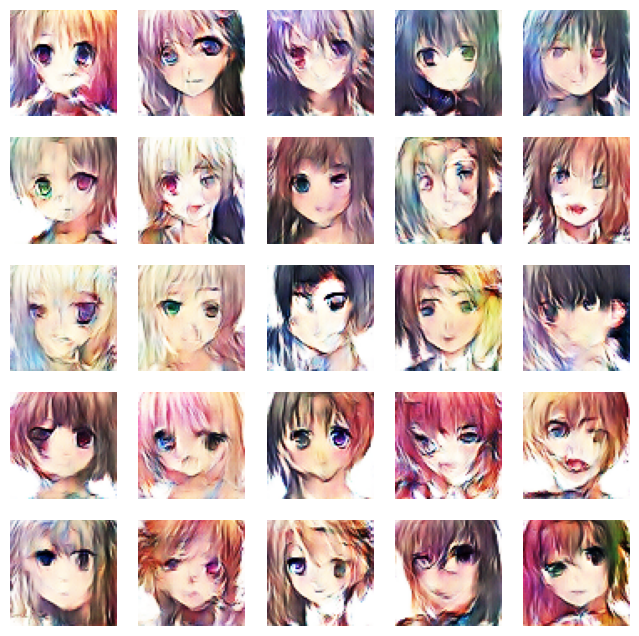

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_17.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.3787 - g_loss: 3.2359
Epoch 18/50
336/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3575 - g_loss: 3.2202

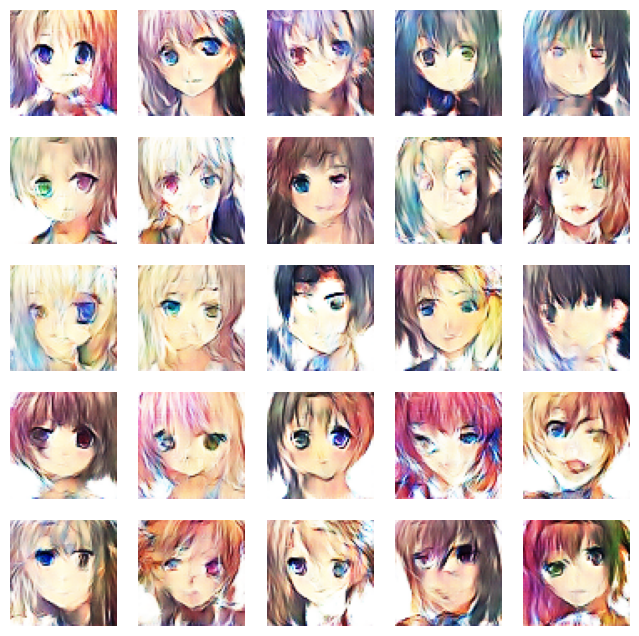

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_18.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.3577 - g_loss: 3.2200
Epoch 19/50
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3255 - g_loss: 3.0320

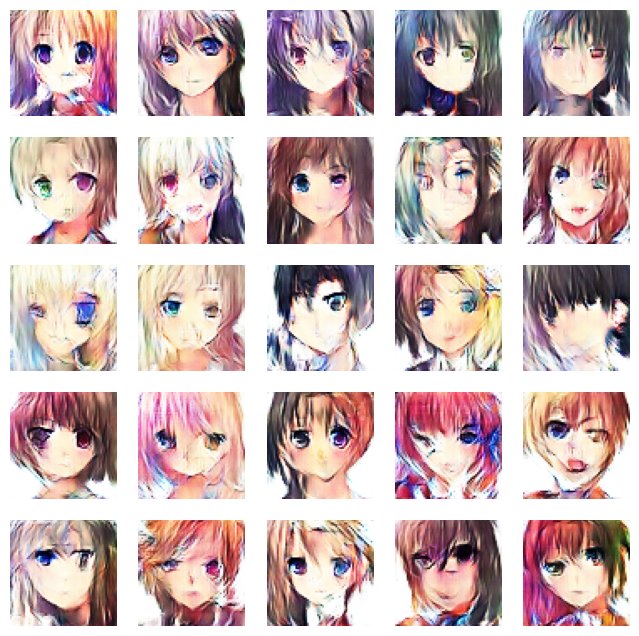

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_19.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - d_loss: 0.3255 - g_loss: 3.0322
Epoch 20/50
334/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3936 - g_loss: 3.1607

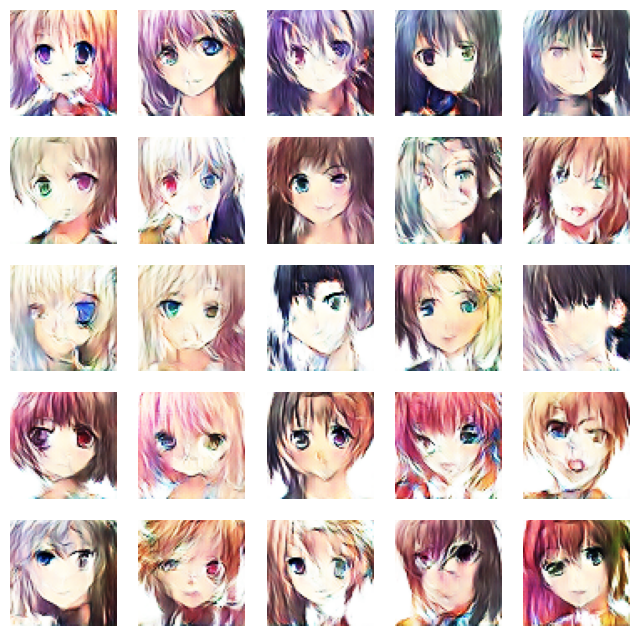

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_20.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 20ms/step - d_loss: 0.3934 - g_loss: 3.1598
Epoch 21/50
331/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3411 - g_loss: 3.0454

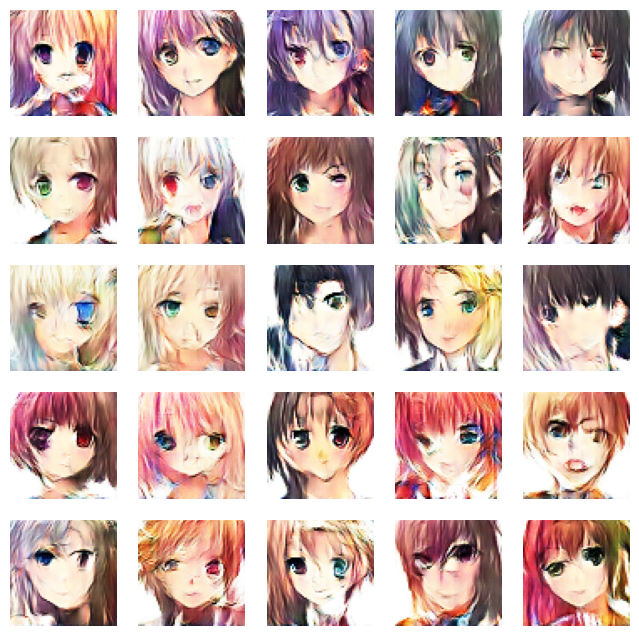

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_21.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - d_loss: 0.3416 - g_loss: 3.0464
Epoch 22/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3617 - g_loss: 2.9647

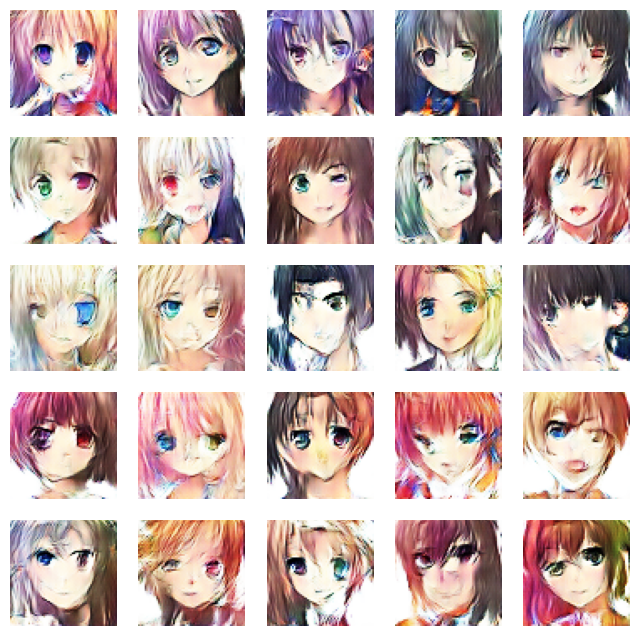

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_22.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.3621 - g_loss: 2.9645
Epoch 23/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3650 - g_loss: 2.9263

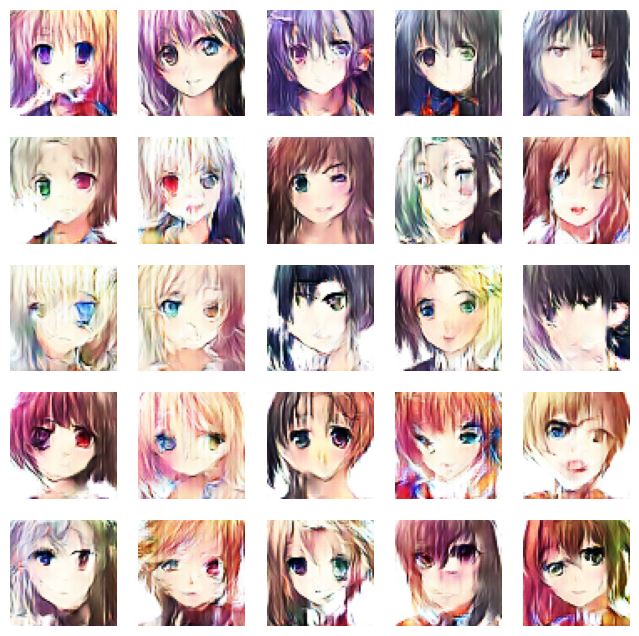

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_23.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 20ms/step - d_loss: 0.3652 - g_loss: 2.9265
Epoch 24/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3749 - g_loss: 2.9048

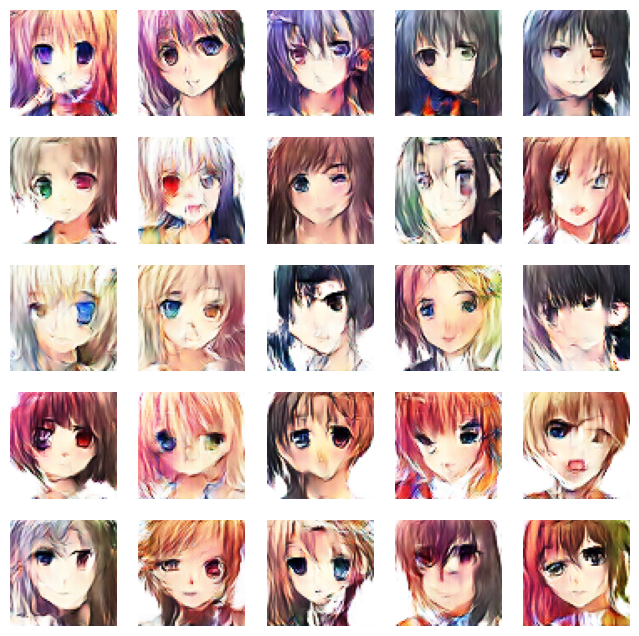

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_24.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - d_loss: 0.3747 - g_loss: 2.9041
Epoch 25/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3764 - g_loss: 2.9551

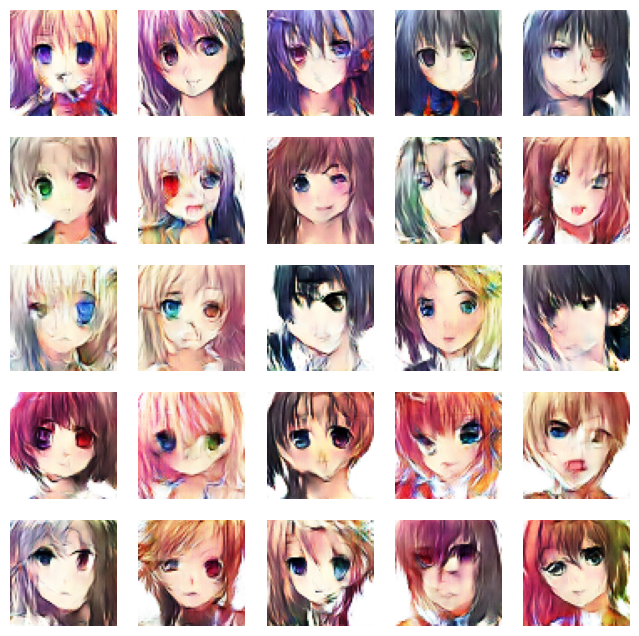

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_25.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 20ms/step - d_loss: 0.3762 - g_loss: 2.9543
Epoch 26/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4093 - g_loss: 2.9682

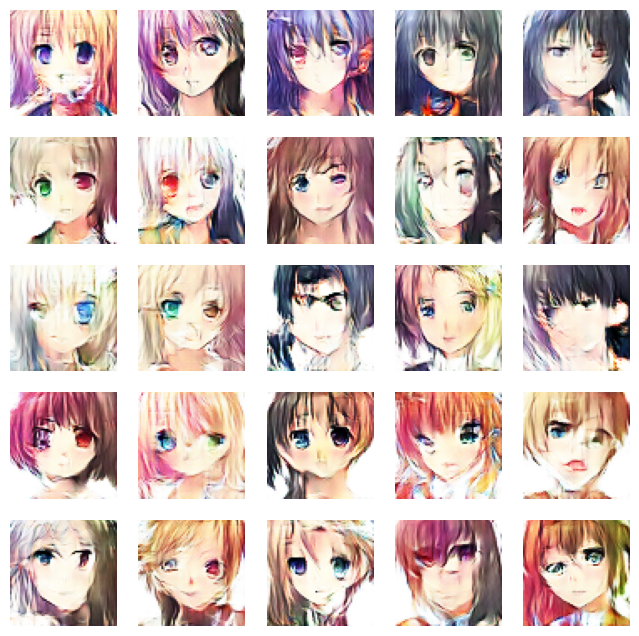

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_26.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - d_loss: 0.4091 - g_loss: 2.9673
Epoch 27/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3944 - g_loss: 2.8391

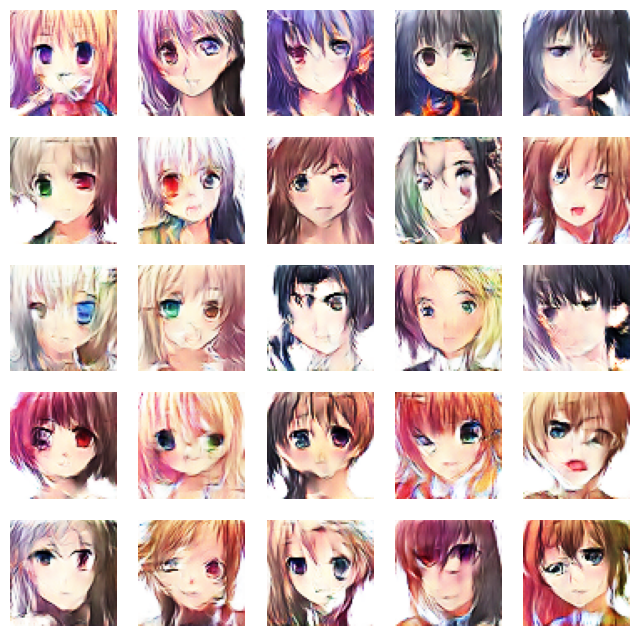

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_27.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.3941 - g_loss: 2.8390
Epoch 28/50
335/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4275 - g_loss: 2.8988

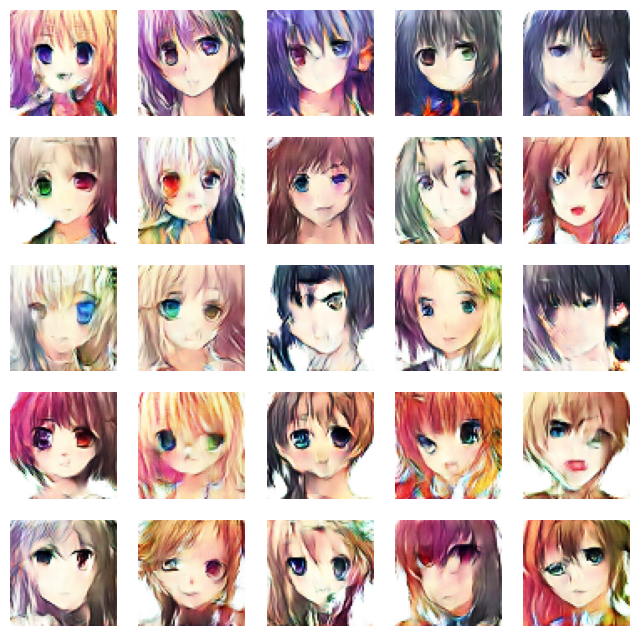

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_28.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.4273 - g_loss: 2.8985
Epoch 29/50
335/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3750 - g_loss: 2.8108

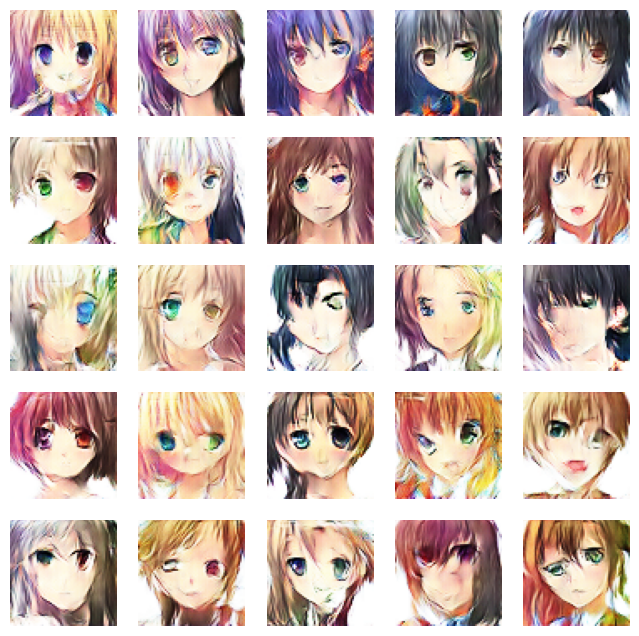

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_29.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - d_loss: 0.3752 - g_loss: 2.8110
Epoch 30/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3632 - g_loss: 2.7395

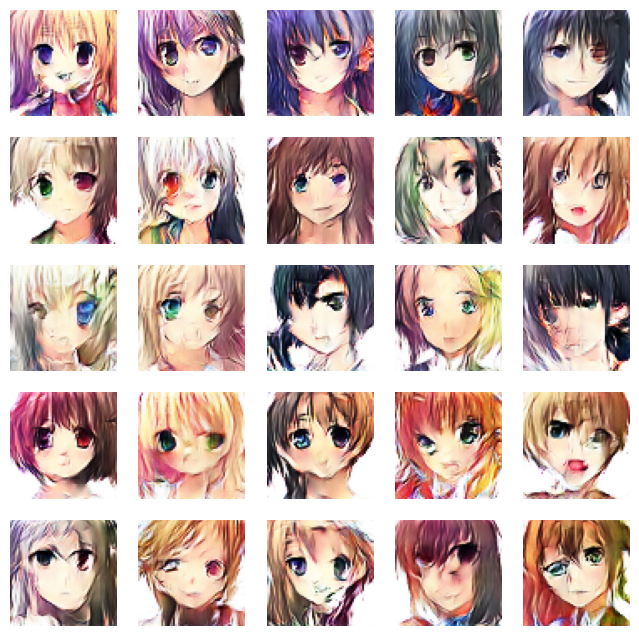

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_30.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - d_loss: 0.3637 - g_loss: 2.7404
Epoch 31/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3756 - g_loss: 2.7606

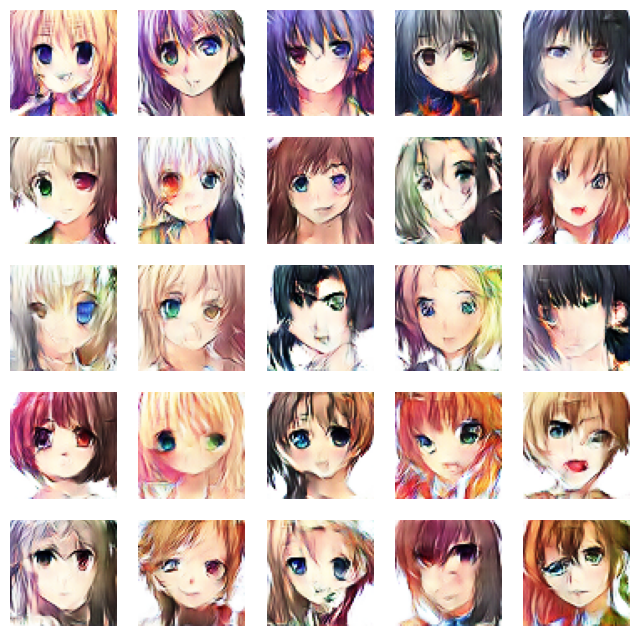

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_31.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.3757 - g_loss: 2.7608
Epoch 32/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3940 - g_loss: 2.7810

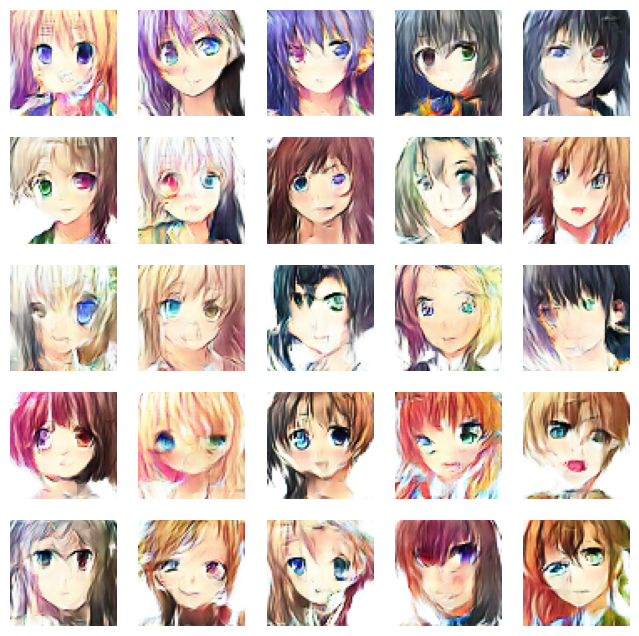

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_32.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - d_loss: 0.3945 - g_loss: 2.7810
Epoch 33/50
331/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3867 - g_loss: 2.6462

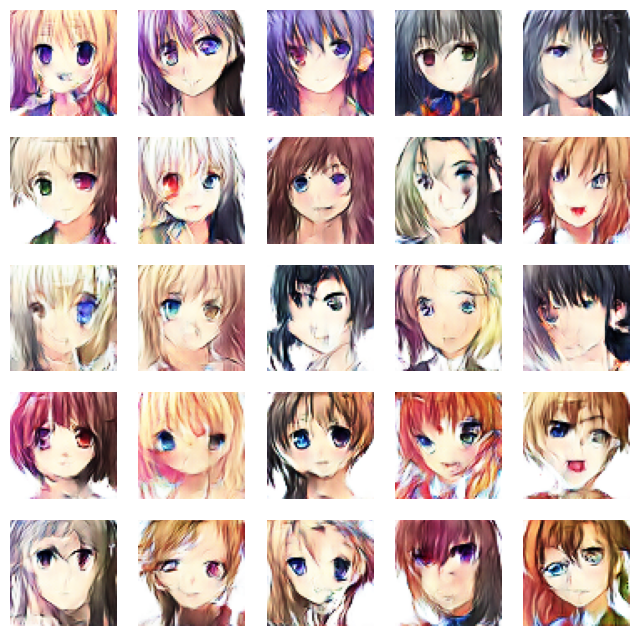

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_33.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.3865 - g_loss: 2.6467
Epoch 34/50
335/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4728 - g_loss: 2.7375

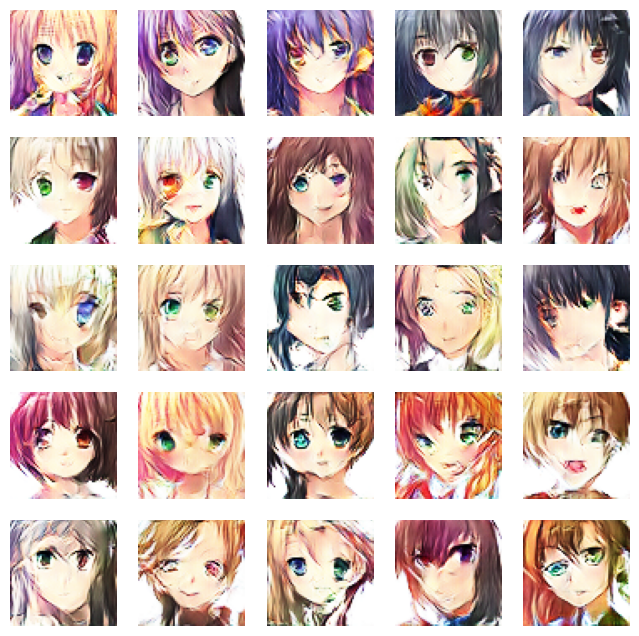

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_34.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.4723 - g_loss: 2.7374
Epoch 35/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - d_loss: 0.4191 - g_loss: 2.7177

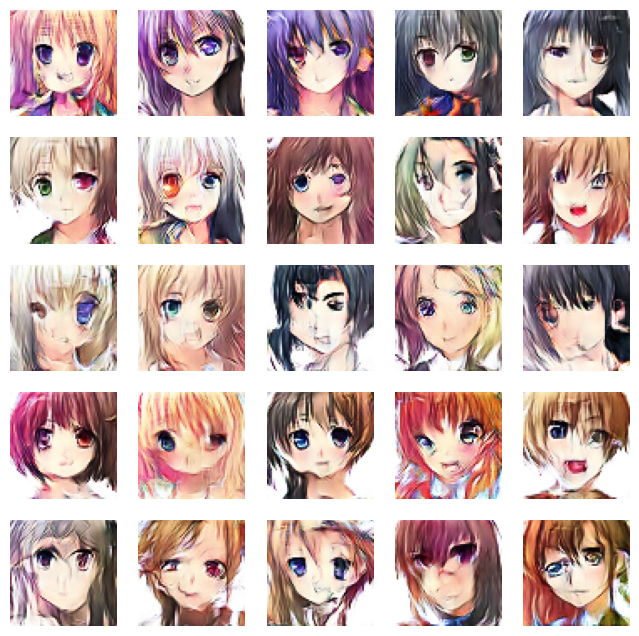

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_35.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - d_loss: 0.4191 - g_loss: 2.7171
Epoch 36/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.3906 - g_loss: 2.6772

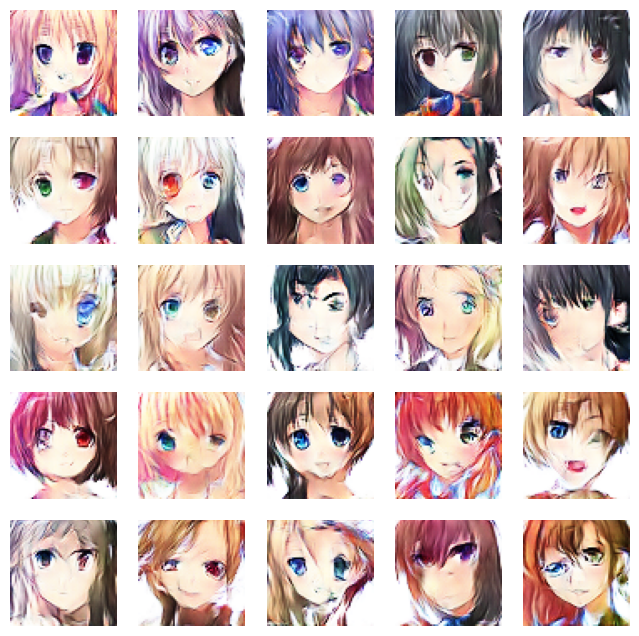

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_36.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - d_loss: 0.3905 - g_loss: 2.6773
Epoch 37/50
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4620 - g_loss: 2.7307

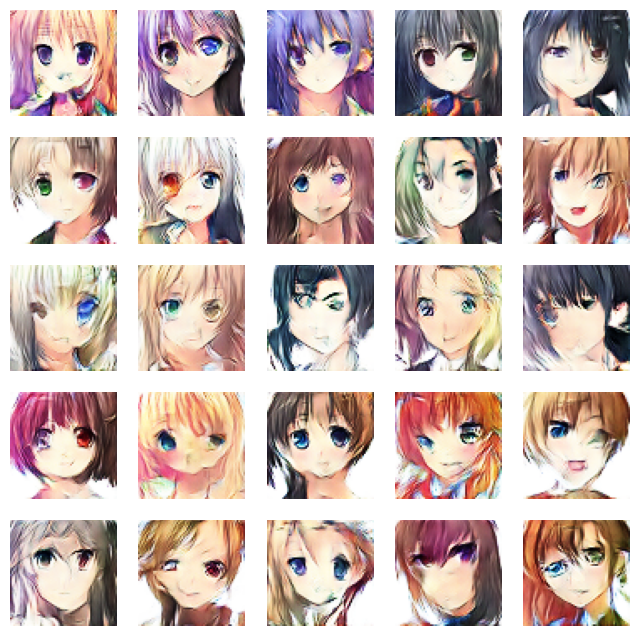

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_37.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - d_loss: 0.4619 - g_loss: 2.7305
Epoch 38/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4019 - g_loss: 2.6104

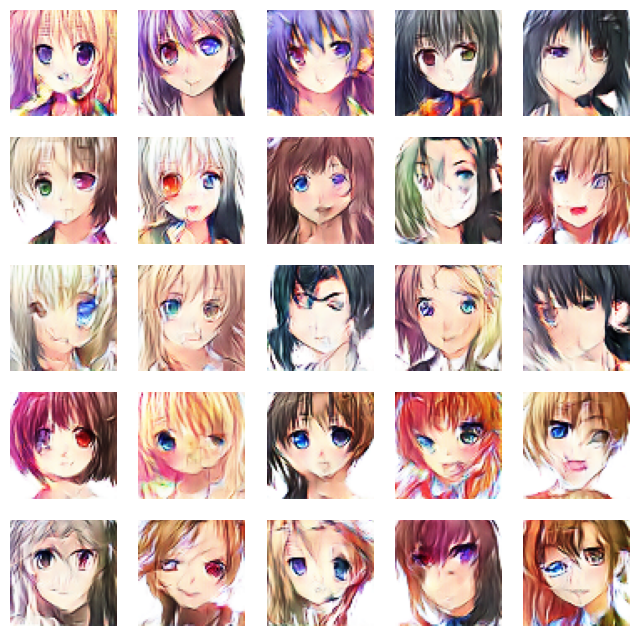

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_38.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.4018 - g_loss: 2.6106
Epoch 39/50
331/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4089 - g_loss: 2.6868

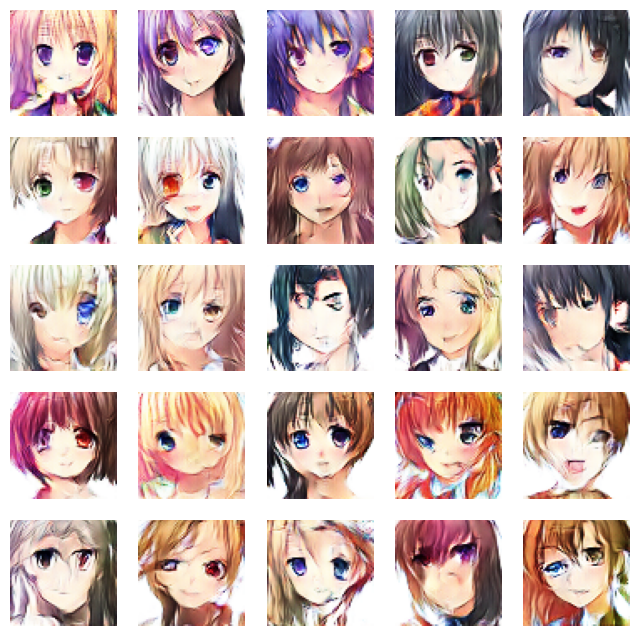

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_39.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - d_loss: 0.4090 - g_loss: 2.6859
Epoch 40/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4268 - g_loss: 2.6720

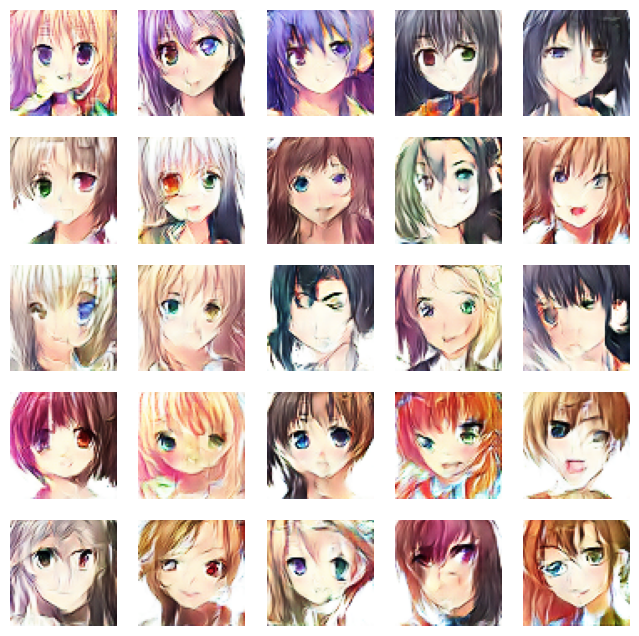

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_40.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.4269 - g_loss: 2.6720
Epoch 41/50
331/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4139 - g_loss: 2.5785

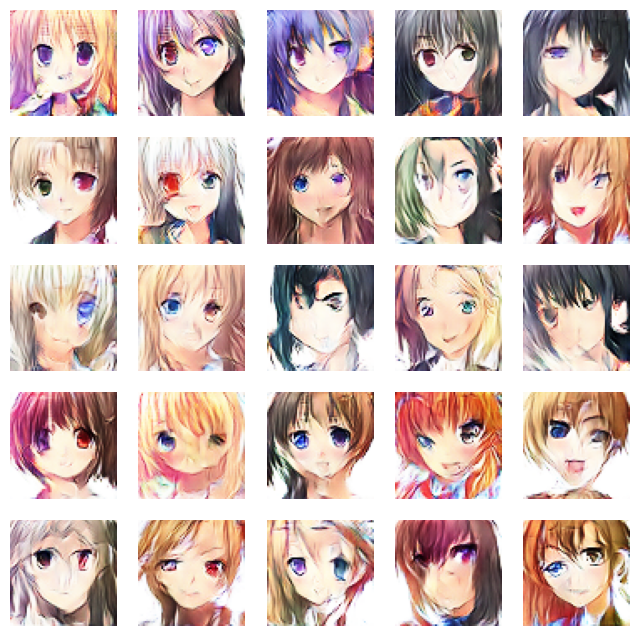

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_41.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.4136 - g_loss: 2.5787
Epoch 42/50
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4393 - g_loss: 2.6236

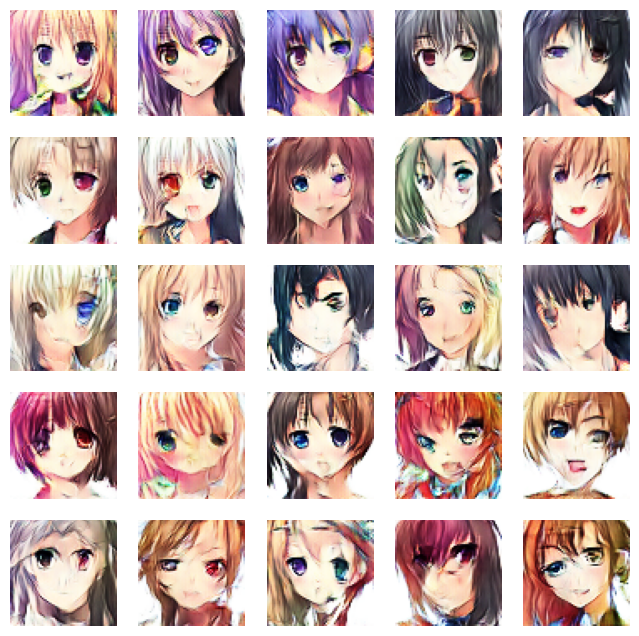

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_42.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.4393 - g_loss: 2.6236
Epoch 43/50
334/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4017 - g_loss: 2.5430

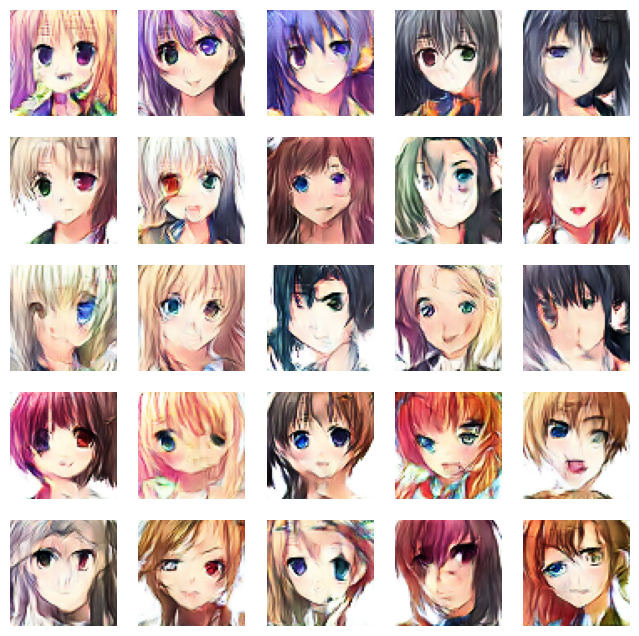

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_43.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.4017 - g_loss: 2.5430
Epoch 44/50
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4308 - g_loss: 2.6496

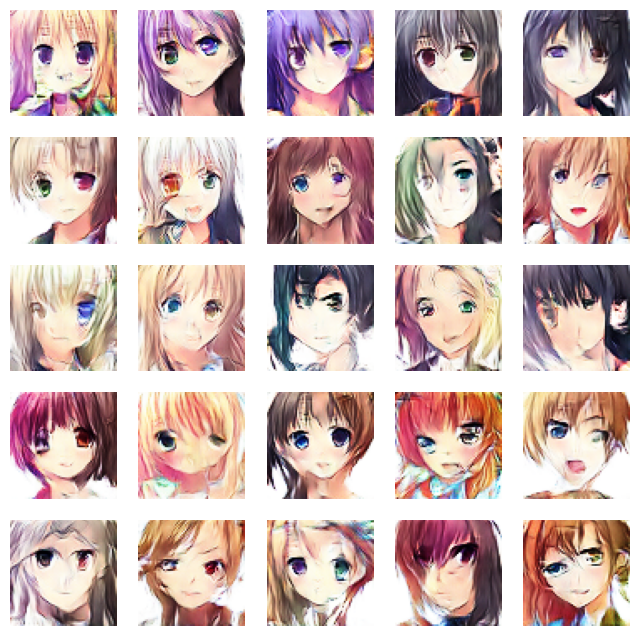

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_44.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.4308 - g_loss: 2.6495
Epoch 45/50
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4116 - g_loss: 2.5084

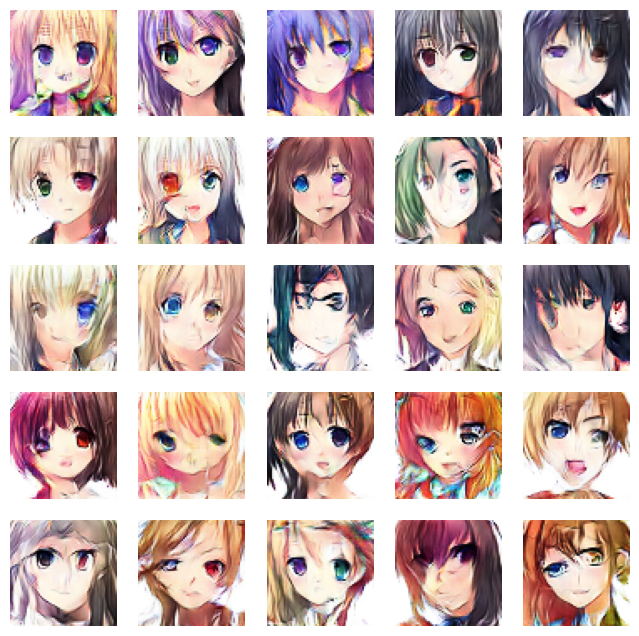

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_45.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.4116 - g_loss: 2.5085
Epoch 46/50
335/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4255 - g_loss: 2.5664

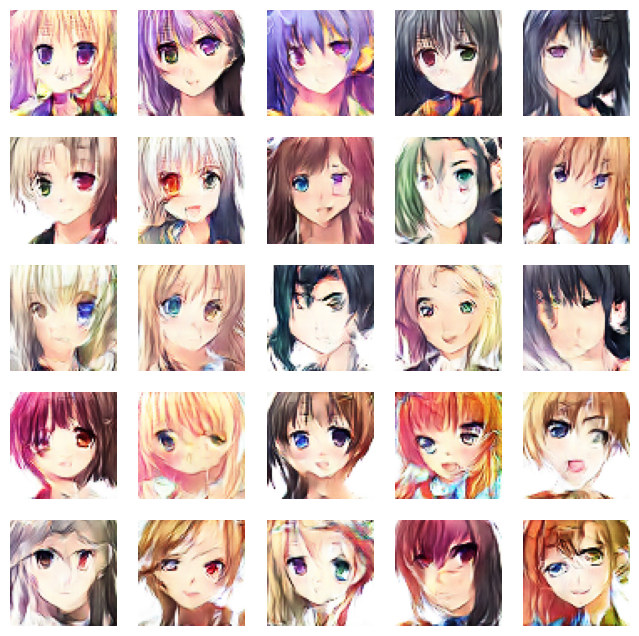

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_46.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.4256 - g_loss: 2.5664
Epoch 47/50
336/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4461 - g_loss: 2.5313

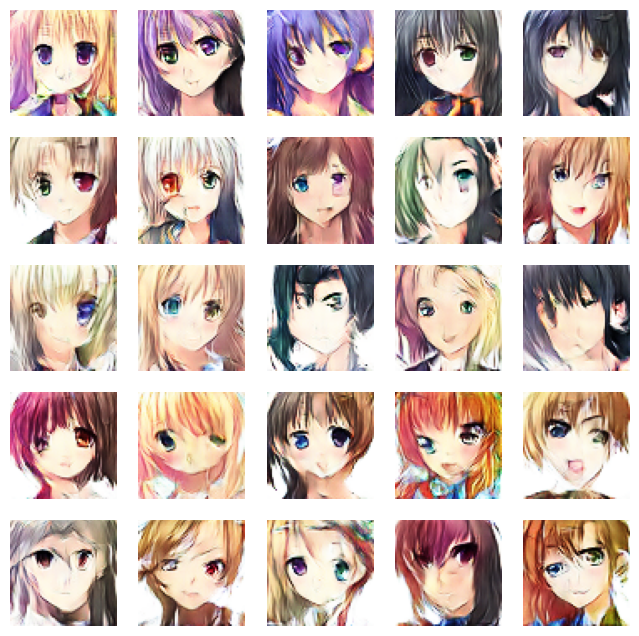

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_47.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - d_loss: 0.4460 - g_loss: 2.5312
Epoch 48/50
331/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4202 - g_loss: 2.4928

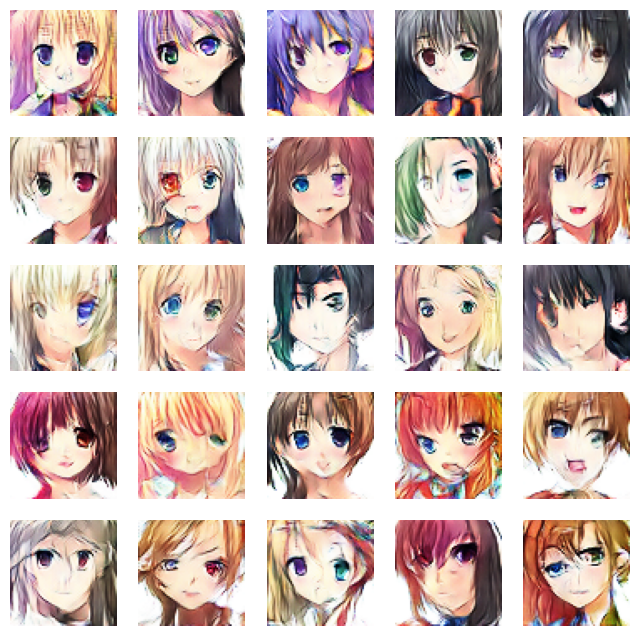

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_48.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - d_loss: 0.4202 - g_loss: 2.4930
Epoch 49/50
333/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4323 - g_loss: 2.5302

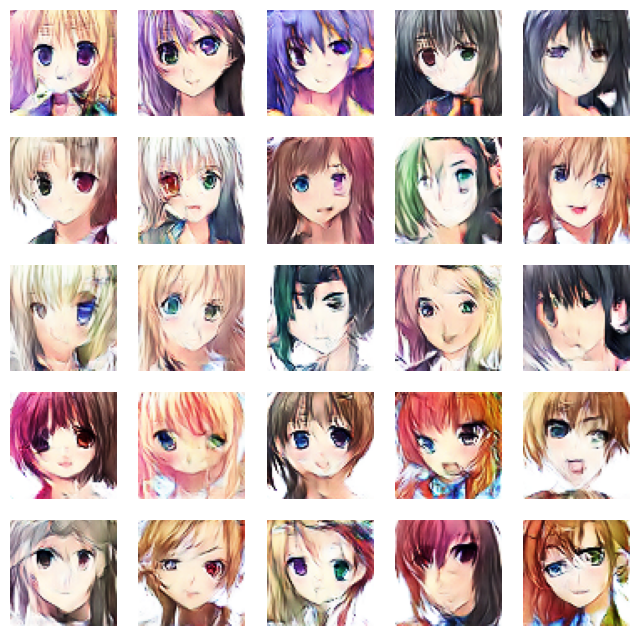

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_49.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - d_loss: 0.4323 - g_loss: 2.5299
Epoch 50/50
332/337 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - d_loss: 0.4137 - g_loss: 2.4713

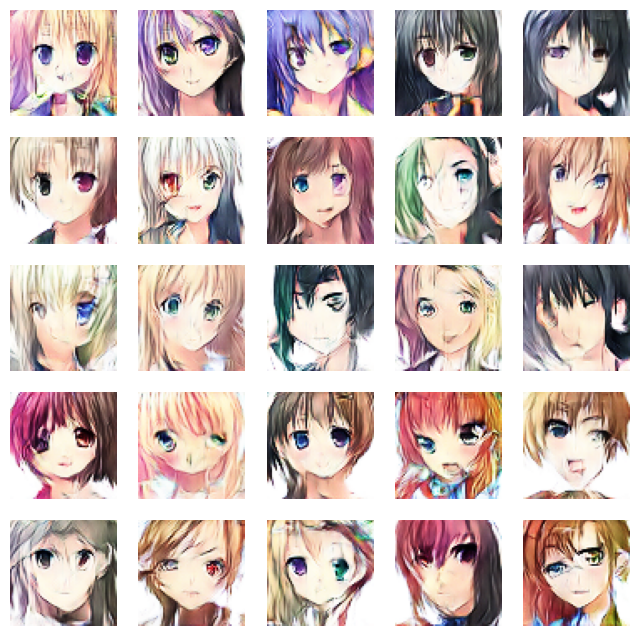

Saved generator to: /content/drive/MyDrive/gan_models/generator_epoch_50.keras
337/337 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - d_loss: 0.4138 - g_loss: 2.4715


In [ ]:
# Compile & Train

G_LR = 1e-4
D_LR = 3e-4
N_EPOCHS = 50

dcgan = DCGAN(generator, discriminator, LATENT_DIM)
dcgan.compile(
    g_optimizer=Adam(G_LR, beta_1=0.5),
    d_optimizer=Adam(D_LR, beta_1=0.5),
    loss_fn=BinaryCrossentropy()
)

dcgan.fit(dataset, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

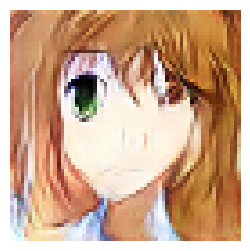

In [ ]:
# Generate a New Image
noise = tf.random.normal([1, LATENT_DIM])
generated_img = dcgan.generator(noise, training=False)
generated_img = (generated_img + 1) * 127.5
generated_img = tf.cast(generated_img, tf.uint8)
plt.figure(figsize=(3,3))
plt.imshow(array_to_img(generated_img[0]))
plt.axis('off')
plt.show()